In [22]:
#only left join
# in degrees

SyntaxError: invalid syntax (1196982179.py, line 1)

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import pandas as pd 
import warnings
warnings.filterwarnings("ignore")
import geopandas as gpd
! pip install folium
import folium
from shapely.geometry import Point
from folium.plugins import MarkerCluster
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.multioutput import MultiOutputRegressor
import os
os.environ['DYLD_LIBRARY_PATH'] = '/opt/homebrew/opt/libomp/lib'
!pip install xgboost
import xgboost as xgb
from xgboost import XGBRegressor
! pip install shap
import shap
!pip install shapash
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import VotingRegressor, StackingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import StratifiedKFold

In [3]:
# Load df_eq and df_well both datasets
df_well = pd.read_excel("df_well_fulljoin1.xlsx") # Wells_fulljoin_1.ipynb
df_eq = pd.read_excel("df_eq.xlsx")

In [4]:
# earthquake dataset size
df_eq.shape

(1714, 4)

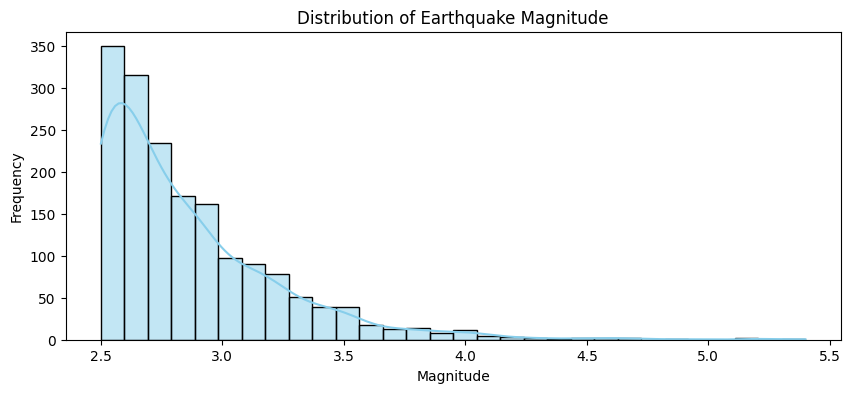

In [5]:
# Plot distribution for magnitude (mag)
plt.figure(figsize=(10, 4))
sns.histplot(df_eq['mag'], kde=True, bins=30, color='skyblue')
plt.title('Distribution of Earthquake Magnitude')
plt.xlabel('Magnitude')
plt.ylabel('Frequency')
# Save the plot as a high-resolution PNG
plt.savefig('earthquake_magnitude_distribution.png', dpi=300, bbox_inches='tight')

plt.show()

In [6]:
df_well.shape

(4974, 16)

In [7]:
df_well.columns 

Index(['API', 'LAT', 'LON', 'Status', 'TotalDepth', 'PlugBackTotalDepth',
       'MeasurementType', 'FluidType', 'Packer', 'PackerDepth',
       'PermitFormationName', 'County', 'Total_Volume', 'Avg_Volume',
       'Avg_PSI', 'geometry'],
      dtype='object')

In [8]:
# Convert df_eq to a GeoDataFrame
df_eq["geometry"] = df_eq.apply(lambda row: Point(row["longitude"], row["latitude"]), axis=1)
df_eq_gdf = gpd.GeoDataFrame(df_eq, geometry="geometry", crs="EPSG:4326")

# Convert df_well to a GeoDataFrame
df_well["geometry"] = df_well.apply(lambda row: Point(row["LON"], row["LAT"]), axis=1)
df_well_gdf = gpd.GeoDataFrame(df_well, geometry="geometry", crs="EPSG:4326") 

In [9]:
# In geopandas.sjoin_nearest(), the how="left" means you are keeping all wells and adding the nearest earthquake to each well.

# Step 1: Perform Nearest Neighbor left Spatial Join
df_spjoin_left = gpd.sjoin_nearest(df_well_gdf, df_eq_gdf, how="left", distance_col="nearest_distance")

# Step 2: Perform Nearest Neighbor right Spatial Join
df_spjoin_right = gpd.sjoin_nearest(df_well_gdf, df_eq_gdf, how="right", distance_col="nearest_distance")

# Step 3 :

#Select required columns: All from df_well and 4 from df_eq
df_spjoin_left = df_spjoin_left[['API', 'LAT', 'LON','mag', 'State', 'nearest_distance', 'Status', 'TotalDepth', 'PlugBackTotalDepth',
                     'MeasurementType', 'FluidType', 'Packer',
                     'PackerDepth', 'PermitFormationName', 'County','Total_Volume' ,'Avg_Volume',
                     'Avg_PSI', 'latitude', 'longitude']]

# Select required columns: All from df_well and 4 from df_eq
df_spjoin_right = df_spjoin_right[['API', 'LAT', 'LON','mag', 'State', 'nearest_distance', 'Status', 'TotalDepth', 'PlugBackTotalDepth',
                    'MeasurementType', 'FluidType', 'Packer',
                     'PackerDepth', 'PermitFormationName', 'County', 'Avg_Volume','Total_Volume' ,
                     'Avg_PSI', 'latitude', 'longitude']]


# Step 3: Combine both datasets
df_combined = pd.concat([df_spjoin_left, df_spjoin_right], ignore_index=True)

# Step 4: Drop duplicates based on common identifying fields
df_deduped = df_combined.drop_duplicates(subset=['API','LAT', 'LON', 'mag', 'latitude', 'longitude'])

# Final dataset
print(f"Final merged and deduplicated dataset has {df_deduped.shape[0]} records.")

Final merged and deduplicated dataset has 6636 records.


In [10]:
df_spjoin_left.head()

,API,LAT,LON,mag,State,nearest_distance,Status,TotalDepth,PlugBackTotalDepth,MeasurementType,FluidType,Packer,PackerDepth,PermitFormationName,County,Total_Volume,Avg_Volume,Avg_PSI,latitude,longitude
0,3500300163,36.896458,-98.179582,2.52,Oklahoma,0.108171,OPEN,5060,4950,CALCULATED,SALTWATER,YES,4933,Others,Others,16200,900.000000,175.0,36.957333,-98.090167
1,3500321107,36.892139,-98.196351,2.52,Oklahoma,0.124601,OPEN,4986,4900,CALCULATED,SALTWATER,YES,4881,Others,Others,24445,1018.541667,175.0,36.957333,-98.090167
2,3500321328,36.674104,-98.515650,2.61,Oklahoma,0.044142,OPEN,7322,3010,METERED,SALTWATER,YES,5127,PERMIAN,Others,5840,243.333333,650.0,36.633500,-98.498333
3,3500321404,36.596660,-98.482960,2.61,Oklahoma,0.039919,OPEN,6312,6262,CALCULATED,SALTWATER,YES,5950,RED FORK,Others,1080,45.000000,90.0,36.633500,-98.498333
4,3500321496,36.645656,-98.426640,2.61,Oklahoma,0.072717,OPEN,6000,5710,METERED,SALTWATER,YES,5710,RED FORK,Others,367481,15977.434783,450.0,36.633500,-98.498333


In [11]:
df_spjoin_right.tail()

,API,LAT,LON,mag,State,nearest_distance,Status,TotalDepth,PlugBackTotalDepth,MeasurementType,FluidType,Packer,PackerDepth,PermitFormationName,County,Avg_Volume,Total_Volume,Avg_PSI,latitude,longitude
1709,3514102078,34.325191,-99.104290,3.5,Texas,5.565015,OPEN,5201,5201,CALCULATED,SALTWATER,YES,5025,STRAWN C,Others,2178.125000,52275,604.791667,31.5940,-103.9530
1710,3514102078,34.325191,-99.104290,3.2,Texas,5.583376,OPEN,5201,5201,CALCULATED,SALTWATER,YES,5025,STRAWN C,Others,2178.125000,52275,604.791667,31.6190,-103.9880
1711,3514102078,34.325191,-99.104290,2.9,Texas,5.581334,OPEN,5201,5201,CALCULATED,SALTWATER,YES,5025,STRAWN C,Others,2178.125000,52275,604.791667,31.6160,-103.9840
1712,3514102078,34.325191,-99.104290,2.5,Texas,5.579585,OPEN,5201,5201,CALCULATED,SALTWATER,YES,5025,STRAWN C,Others,2178.125000,52275,604.791667,31.6160,-103.9820
1713,3505320531,36.986798,-97.550265,3.4,Kansas,2.100188,CLOSED,4470,3150,CALCULATED,SALTWATER,YES,3150,Others,Others,1412.727273,15540,354.545455,39.0869,-97.5693


In [12]:
df_deduped = df_spjoin_left

In [13]:
df_deduped.head()

,API,LAT,LON,mag,State,nearest_distance,Status,TotalDepth,PlugBackTotalDepth,MeasurementType,FluidType,Packer,PackerDepth,PermitFormationName,County,Total_Volume,Avg_Volume,Avg_PSI,latitude,longitude
0,3500300163,36.896458,-98.179582,2.52,Oklahoma,0.108171,OPEN,5060,4950,CALCULATED,SALTWATER,YES,4933,Others,Others,16200,900.000000,175.0,36.957333,-98.090167
1,3500321107,36.892139,-98.196351,2.52,Oklahoma,0.124601,OPEN,4986,4900,CALCULATED,SALTWATER,YES,4881,Others,Others,24445,1018.541667,175.0,36.957333,-98.090167
2,3500321328,36.674104,-98.515650,2.61,Oklahoma,0.044142,OPEN,7322,3010,METERED,SALTWATER,YES,5127,PERMIAN,Others,5840,243.333333,650.0,36.633500,-98.498333
3,3500321404,36.596660,-98.482960,2.61,Oklahoma,0.039919,OPEN,6312,6262,CALCULATED,SALTWATER,YES,5950,RED FORK,Others,1080,45.000000,90.0,36.633500,-98.498333
4,3500321496,36.645656,-98.426640,2.61,Oklahoma,0.072717,OPEN,6000,5710,METERED,SALTWATER,YES,5710,RED FORK,Others,367481,15977.434783,450.0,36.633500,-98.498333


In [14]:
df_deduped.shape

(4974, 20)

In [15]:
# Initialize a map centered around the average location
map_center = [df_deduped["latitude"].mean(), df_deduped["longitude"].mean()]
m = folium.Map(location=map_center, zoom_start=6)

# Marker Clusters
well_cluster = MarkerCluster(name="Wells").add_to(m)
eq_cluster = MarkerCluster(name="Earthquakes").add_to(m)

# Plot Wells (Blue Markers)
for _, row in df_deduped.iterrows():
    folium.CircleMarker(
        location=[row["LAT"], row["LON"]],
        radius=5,
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opacity=0.7,
        popup=f"Well - API: {row['API']} | Depth: {row['TotalDepth']} ft"
    ).add_to(well_cluster)

# Plot Earthquakes (Red Markers)
for _, row in df_deduped.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=5,
        color="red",
        fill=True,
        fill_color="red",
        fill_opacity=0.7,
        popup=f"Earthquake - Mag: {row['mag']} | State: {row['State']}"
    ).add_to(eq_cluster)

# Draw Lines Between Wells and Earthquakes
for _, row in df_deduped.iterrows():
    folium.PolyLine(
        locations=[[row["LAT"], row["LON"]], [row["latitude"], row["longitude"]]],
        color="black",
        weight=1.5,
        opacity=0.7
    ).add_to(m)

# Add Layer Control
folium.LayerControl().add_to(m)

# Save and display map
m.save("earthquake_well_mapping_deduped.html")
m

In [16]:
# Initialize a map centered around the average location
map_center = [df_deduped["latitude"].mean(), df_deduped["longitude"].mean()]
m = folium.Map(location=map_center, zoom_start=6)

# Marker Clusters
well_cluster = MarkerCluster(name="Wells").add_to(m)
eq_cluster = MarkerCluster(name="Earthquakes").add_to(m)

# Plot Wells (Blue Markers)
for _, row in df_deduped.iterrows():
    folium.CircleMarker(
        location=[row["LAT"], row["LON"]],
        radius=5,
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opacity=0.7,
        popup=f"Well - API: {row['API']} | Depth: {row['TotalDepth']} ft"
    ).add_to(well_cluster)

# Plot Earthquakes (Red Markers)
for _, row in df_deduped.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=5,
        color="red",
        fill=True,
        fill_color="red",
        fill_opacity=0.7,
        popup=f"Earthquake - Mag: {row['mag']} | State: {row['State']}"
    ).add_to(eq_cluster)

# Draw Lines Between Wells and Earthquakes
for _, row in df_deduped.iterrows():
    folium.PolyLine(
        locations=[[row["LAT"], row["LON"]], [row["latitude"], row["longitude"]]],
        color="black",
        weight=1.5,
        opacity=0.7
    ).add_to(m)

from geopy.distance import geodesic

for _, row in df_deduped.iterrows():
    # Start and end coordinates
    start = (row["LAT"], row["LON"])
    end = (row["latitude"], row["longitude"])

    # Calculate midpoint for label
    midpoint = [(start[0] + end[0]) / 2, (start[1] + end[1]) / 2]

    # Add a label with distance in miles
    folium.Marker(
        location=midpoint,
        icon=folium.DivIcon(
            html=f"""<div style="font-size: 10px; color: black; text-align: center;">
                     {row['nearest_distance']:.2f} de</div>"""
        )
    ).add_to(m)
    
# Add Layer Control
folium.LayerControl().add_to(m)

# Save and display map
m.save("earthquake_well_mapping_deduped_miles.html")
m

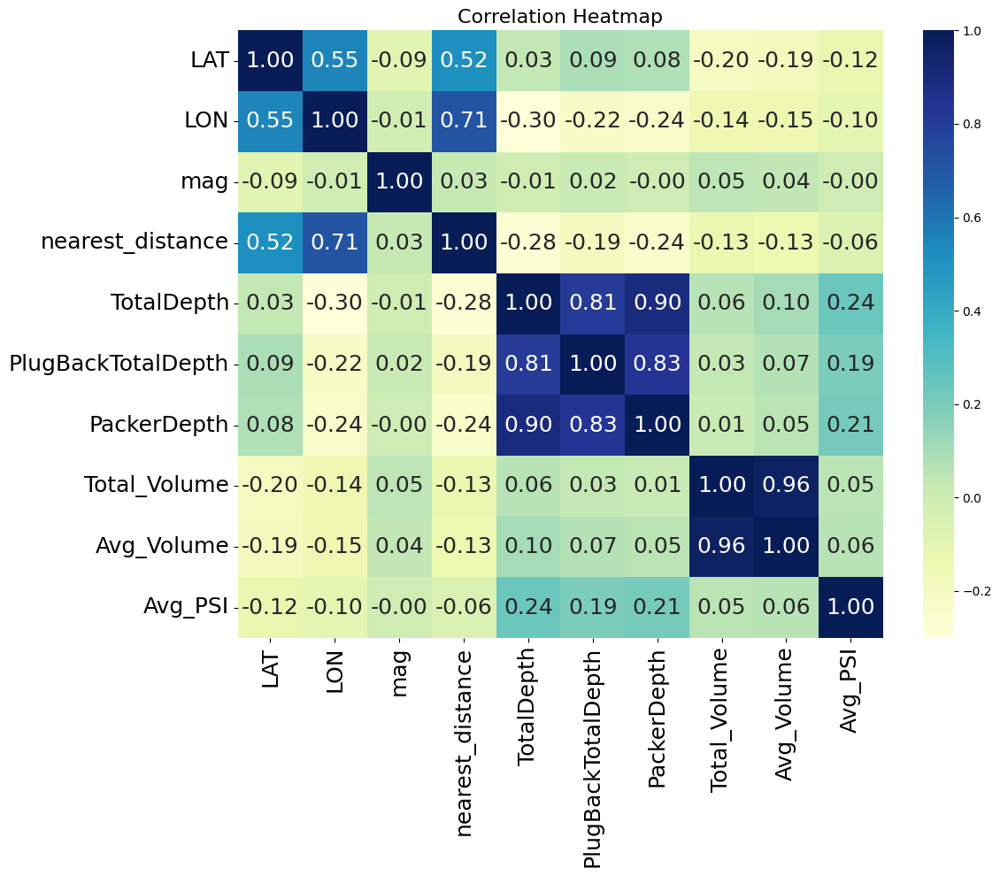

In [17]:
df_corr = df_deduped.drop(['API','latitude', 'longitude'], axis=1)

# Compute correlation matrix on remaining numerical columns
corr_matrix = df_corr.select_dtypes(include=['number']).corr()

# Plot the heatmap
# plt.figure(figsize=(12, 8))
# sns.heatmap(corr_matrix, annot=True, cmap='YlGnBu')
# plt.title("Correlation Matrix (Excluding Selected Columns)")
# plt.savefig('Heatmap.png', dpi=300, bbox_inches='tight')
# plt.show()


plt.figure(figsize=(12, 10))
sns.heatmap(
    corr_matrix,
    annot=True,
    fmt=".2f",
    cmap="YlGnBu",
    annot_kws={"size": 18},        # Font size of numbers in cells
    xticklabels=1,                 # Show all labels
    yticklabels=1                  # Show all labels
)
plt.xticks(fontsize=18)            # Font size of x-axis labels
plt.yticks(fontsize=18)            # Font size of y-axis labels
plt.title("Correlation Heatmap", fontsize=16)  # Title font size
plt.tight_layout()
plt.savefig('Heatmap.png', dpi=300, bbox_inches='tight')

plt.show()

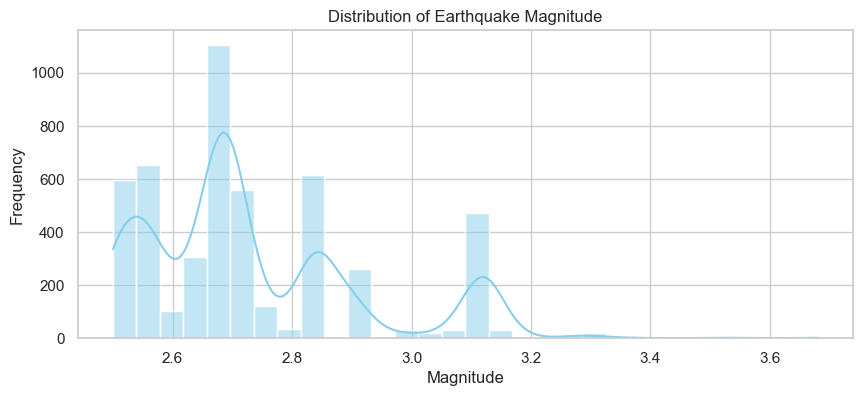

In [18]:
# Set style
sns.set(style="whitegrid")

# Plot distribution for magnitude (mag)
plt.figure(figsize=(10, 4))
sns.histplot(df_deduped['mag'], kde=True, bins=30, color='skyblue')
plt.title('Distribution of Earthquake Magnitude')
plt.xlabel('Magnitude')
plt.ylabel('Frequency')
plt.show()

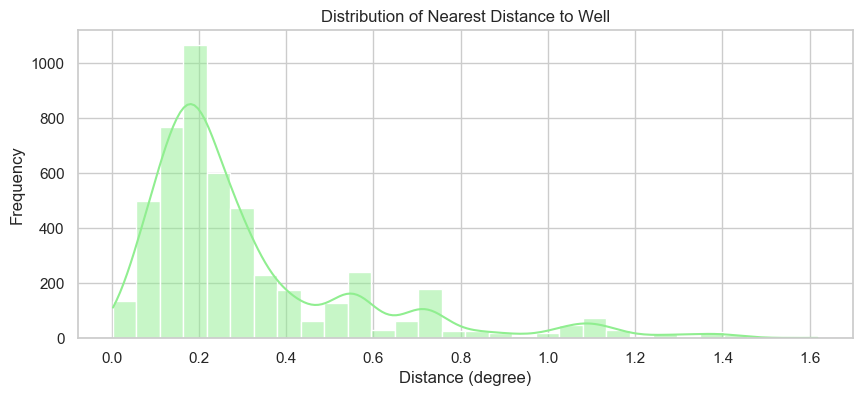

In [19]:
# Plot distribution for nearest_distance
plt.figure(figsize=(10, 4))
sns.histplot(df_deduped['nearest_distance'], kde=True, bins=30, color='lightgreen')
plt.title('Distribution of Nearest Distance to Well')
plt.xlabel('Distance (degree)')
plt.ylabel('Frequency')
plt.show()

In [20]:
# Target: mag
# Features: Avg_PSI, Avg_Volume
well_features = [
    'LAT', 'LON', 'Status', 'TotalDepth', 'PlugBackTotalDepth',
    'MeasurementType', 'FluidType',
    'Packer', 'PackerDepth', 'PermitFormationName', 'County',
    'Avg_Volume', 'Avg_PSI'
]

target_vars = ['mag', 'nearest_distance']

In [21]:
df = df_deduped 

# Linear Regression 

In [22]:
# Redefine feature and target variable lists
# well_features = [
#     'LAT', 'LON', 'Status', 'TotalDepth', 'PlugBackTotalDepth',
#     'MeasurementType', 'FluidType', 'Packer', 'PackerDepth',
#     'PermitFormationName', 'County', 'Total_Volume', 'Avg_Volume', 'Avg_PSI'
# ]
# target_vars = ['mag']

# Assign features and target
X = df[well_features]
y = df['mag']

# Log-transform the target
y_log = np.log1p(y)  # Use log1p to handle zero or near-zero values

# Bin target into quantiles for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# One-hot encoding for categorical variables
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# Create pipeline
model_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# Initialize Stratified K-Fold
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Lists to store results
r2_scores_lr_mag, mse_scores_lr_mag = [], []
actuals_lr_mag, predictions_lr_mag = [], []

# Cross-validation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    model_pipeline.fit(X_train, y_train)
    y_pred_log = model_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_lr_mag.append(r2_score(y_val_actual, y_pred))
    mse_scores_lr_mag.append(mean_squared_error(y_val_actual, y_pred))
    actuals_lr_mag.extend(y_val_actual)
    predictions_lr_mag.extend(y_pred)

# Convert to arrays for plotting
actuals_lr_mag = np.array(actuals_lr_mag)
predictions_lr_mag = np.array(predictions_lr_mag)

# Final averaged metrics
avg_r2_lr_mag = np.mean(r2_scores_lr_mag)
avg_mse_lr_mag = np.mean(mse_scores_lr_mag)
print("Linear Reg R² (mag):", avg_r2_lr_mag)
print("Linear Reg MSE(mag) :", avg_mse_lr_mag)

Linear Reg R² (mag): 0.3628755290168478
Linear Reg MSE(mag) : 0.021495598517846486


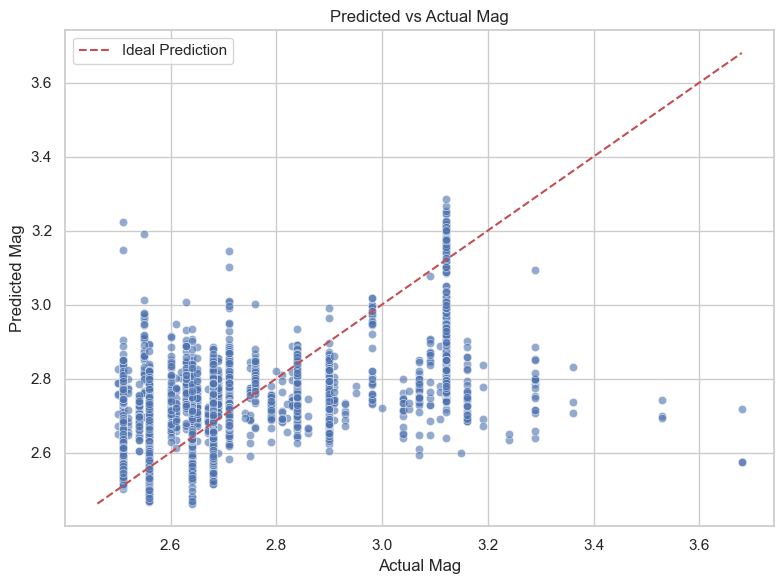

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set plot style
sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=actuals_lr_mag, y=predictions_lr_mag, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_lr_mag), max(predictions_lr_mag))
min_val = min(min(actuals_lr_mag), min(predictions_lr_mag))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Label and title
plt.xlabel("Actual Mag")
plt.ylabel("Predicted Mag")
plt.title("Predicted vs Actual Mag")
plt.legend()
plt.tight_layout()
plt.show()

In [24]:
# Redefine feature and target variable lists
# well_features = [
#     'LAT', 'LON', 'Status', 'TotalDepth', 'PlugBackTotalDepth',
#     'MeasurementType', 'FluidType', 'Packer', 'PackerDepth',
#     'PermitFormationName', 'County', 'Total_Volume', 'Avg_Volume', 'Avg_PSI'
# ]
# target_vars = ['mag']

# Assign features and target
X = df[well_features]
y = df['nearest_distance']

# Log-transform the target
y_log = np.log1p(y)  # Use log1p to handle zero or near-zero values

# Bin target into quantiles for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# One-hot encoding for categorical variables
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# Create pipeline
model_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# Initialize Stratified K-Fold
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Lists to store results
r2_scores_lr_dist, mse_scores_lr_dist = [], []
actuals_lr_dist, predictions_lr_dist = [], []

# Cross-validation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    model_pipeline.fit(X_train, y_train)
    y_pred_log = model_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_lr_dist.append(r2_score(y_val_actual, y_pred))
    mse_scores_lr_dist.append(mean_squared_error(y_val_actual, y_pred))
    actuals_lr_dist.extend(y_val_actual)
    predictions_lr_dist.extend(y_pred)

# Convert to arrays for plotting
actuals_lr_dist = np.array(actuals_lr_dist)
predictions_lr_dist = np.array(predictions_lr_dist)

# Print metrics
avg_r2_lr_dist = np.mean(r2_scores_lr_dist)
avg_mse_lr_dist = np.mean(mse_scores_lr_dist)

print("Linear Reg R² (dist):", avg_r2_lr_dist)
print("Linear Reg MSE(dist) :", avg_mse_lr_dist)

Linear Reg R² (dist): 0.6689020405504039
Linear Reg MSE(dist) : 0.022687448461294342


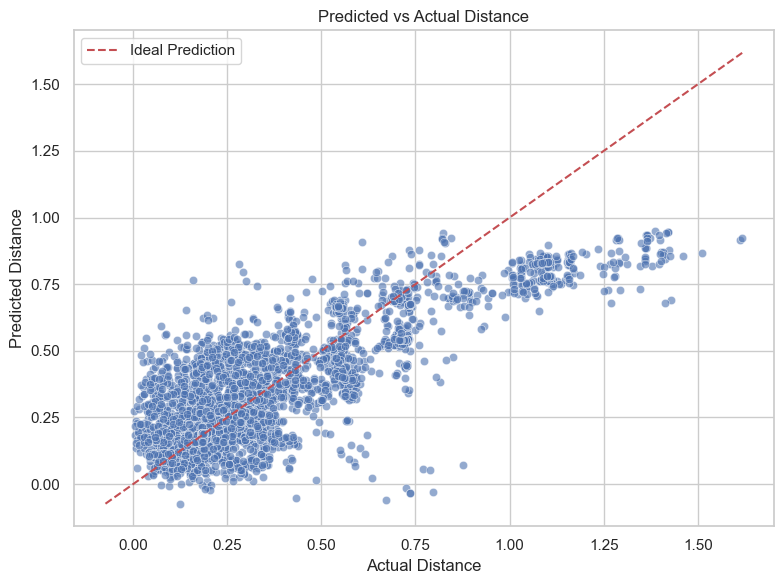

In [25]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set plot style
sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=actuals_lr_dist, y=predictions_lr_dist, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_lr_dist), max(predictions_lr_dist))
min_val = min(min(actuals_lr_dist), min(predictions_lr_dist))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Label and title
plt.xlabel("Actual Distance")
plt.ylabel("Predicted Distance")
plt.title("Predicted vs Actual Distance")
plt.legend()
plt.tight_layout()
plt.show()

### Random Forest

In [26]:
# Define features and target
X = df[well_features]
y = df['mag']

# Log-transform the target
y_log = np.log1p(y)

# Bin target for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# Preprocessing: One-hot encode categoricals, pass through numericals
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# Random Forest pipeline
rf_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(n_estimators=100, random_state=42))
])

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Store metrics and predictions
r2_scores_rf_mag, mse_scores_rf_mag = [], []
actuals_rf_mag, predictions_rf_mag = [], []

# K-Fold training and evaluation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    rf_pipeline.fit(X_train, y_train)
    y_pred_log = rf_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_rf_mag.append(r2_score(y_val_actual, y_pred))
    mse_scores_rf_mag.append(mean_squared_error(y_val_actual, y_pred))
    actuals_rf_mag.extend(y_val_actual)
    predictions_rf_mag.extend(y_pred)

# Convert to arrays
actuals_rf_mag = np.array(actuals_rf_mag)
predictions_rf_mag = np.array(predictions_rf_mag)

# Final averaged metrics
avg_r2_rf_mag = np.mean(r2_scores_rf_mag)
avg_mse_rf_mag = np.mean(mse_scores_rf_mag)
print("Random Forest R² (mag):", avg_r2_rf_mag)
print("Random Forest MSE(mag) :", avg_mse_rf_mag)

Random Forest R² (mag): 0.847211840248719
Random Forest MSE(mag) : 0.005149515101591668


 99%|===================| 4920/4974 [00:30<00:00]        

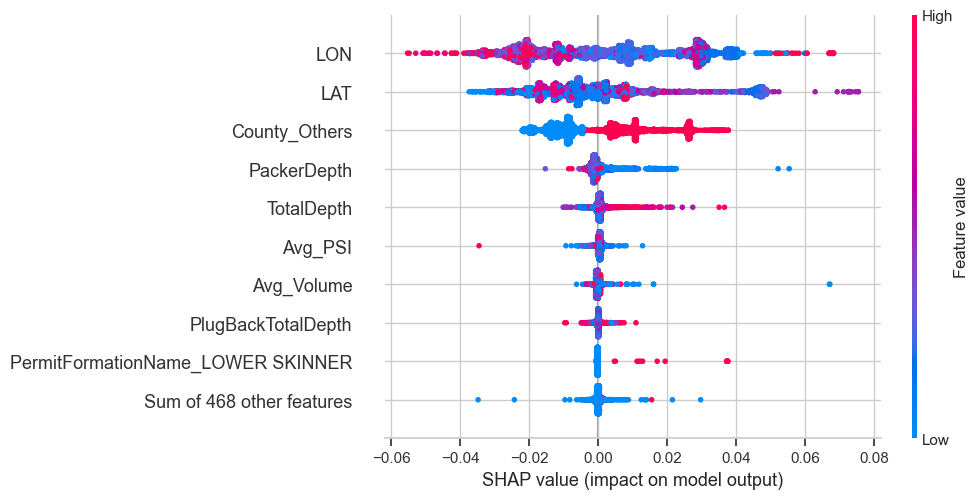

In [27]:
import shap
import numpy as np

# 1. Extract trained components
preprocessor = rf_pipeline.named_steps['preprocessor']
regressor = rf_pipeline.named_steps['regressor']

# 2. Transform input features
X_transformed = preprocessor.transform(X)

# 3. Convert to dense if it's sparse (common with OneHotEncoder)
if hasattr(X_transformed, "toarray"):
    X_transformed = X_transformed.toarray()

# 4. Get proper feature names
encoded_cats = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_features)
feature_names = np.concatenate([numerical_features, encoded_cats])

# 5. Run SHAP TreeExplainer
explainer = shap.Explainer(regressor, X_transformed, feature_names=feature_names)
shap_values = explainer(X_transformed)

# 6. Plot SHAP summary
shap.plots.beeswarm(shap_values)

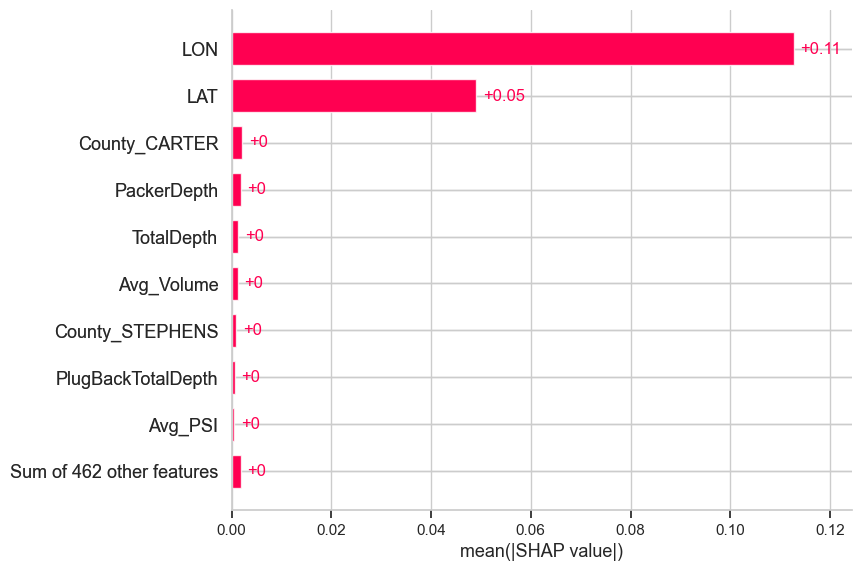

In [84]:
# Top 10 features bar chart
shap.plots.bar(shap_values, max_display=10)

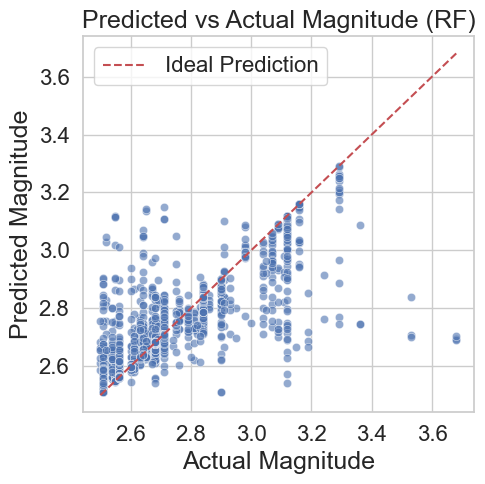

In [32]:
# Set plot style
import seaborn as sns
import matplotlib.pyplot as plt

sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(5, 5))  # Increased figure size
sns.scatterplot(x=actuals_rf_mag, y=predictions_rf_mag, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_rf_mag), max(predictions_rf_mag))
min_val = min(min(actuals_rf_mag), min(predictions_rf_mag))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Labels and title with increased font size
plt.xlabel("Actual Magnitude", fontsize=18)
plt.ylabel("Predicted Magnitude", fontsize=18)
plt.title("Predicted vs Actual Magnitude (RF)", fontsize=18)
plt.legend(fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

# Layout and save
plt.tight_layout()
plt.savefig('ActvsPred_RF_mag_highres.png', dpi=300, bbox_inches='tight')
plt.show()

In [29]:
# Define features and target
X = df[well_features]
y = df['nearest_distance']

# Log-transform the target
y_log = np.log1p(y)

# Bin target for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# Preprocessing: One-hot encode categoricals, pass through numericals
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# Random Forest pipeline
rf_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(n_estimators=100, random_state=42))
])

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Store metrics and predictions
r2_scores_rf_dist, mse_scores_rf_dist = [], []
actuals_rf_dist, predictions_rf_dist = [], []

# K-Fold training and evaluation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    rf_pipeline.fit(X_train, y_train)
    y_pred_log = rf_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_rf_dist.append(r2_score(y_val_actual, y_pred))
    mse_scores_rf_dist.append(mean_squared_error(y_val_actual, y_pred))
    actuals_rf_dist.extend(y_val_actual)
    predictions_rf_dist.extend(y_pred)

# Convert to arrays
actuals_rf_dist = np.array(actuals_rf_dist)
predictions_rf_dist = np.array(predictions_rf_dist)

# Final averaged metrics
avg_r2_rf_dist = np.mean(r2_scores_rf_dist)
avg_mse_rf_dist = np.mean(mse_scores_rf_dist)
print("Random Forest R²(Dist):", avg_r2_rf_dist)
print("Random Forest MSE(dist):", avg_mse_rf_dist)


Random Forest R²(Dist): 0.9926895648926533
Random Forest MSE(dist): 0.0004964295173369424


100%|===================| 4964/4974 [00:56<00:00]        

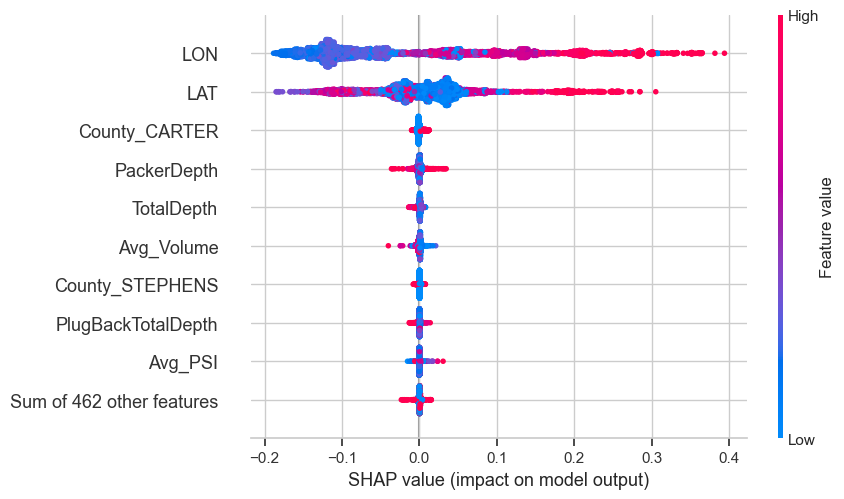

In [85]:
import shap
import numpy as np

# 1. Extract fitted preprocessor and regressor from pipeline
preprocessor = rf_pipeline.named_steps['preprocessor']
regressor = rf_pipeline.named_steps['regressor']

# 2. Transform original input data (X)
X_transformed = preprocessor.transform(X)

# 3. Convert to dense array if sparse
if hasattr(X_transformed, "toarray"):
    X_transformed = X_transformed.toarray()

# 4. Get feature names for SHAP plot
encoded_cats = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_features)
feature_names = np.concatenate([numerical_features, encoded_cats])

# 5. Create SHAP explainer
explainer = shap.Explainer(regressor, X_transformed, feature_names=feature_names)
shap_values = explainer(X_transformed)

# 6. Plot SHAP beeswarm summary
shap.plots.beeswarm(shap_values)

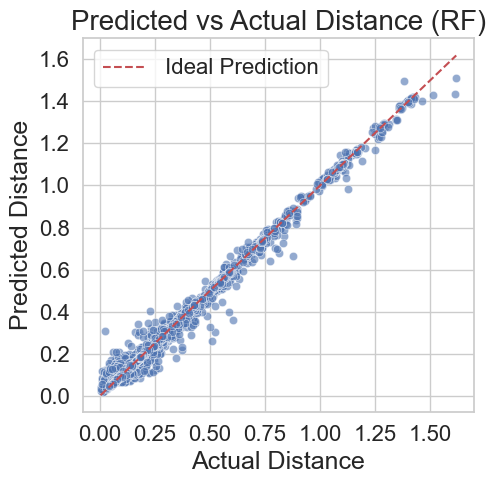

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns

# # Set plot style
# sns.set(style='whitegrid', context='notebook')

# # Create scatter plot
# plt.figure(figsize=(8, 6))
# sns.scatterplot(x=actuals_rf_dist, y=predictions_rf_dist, alpha=0.6)

# # Plot ideal line (perfect prediction)
# max_val = max(max(actuals_rf_dist), max(predictions_rf_dist))
# min_val = min(min(actuals_rf_dist), min(predictions_rf_dist))
# plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# # Label and title
# plt.xlabel("Actual Distance")
# plt.ylabel("Predicted Distance")
# plt.title("Predicted vs Actual Distance(RF)")
# plt.legend()
# plt.tight_layout()
# plt.savefig('ActvsPred_RF_dist.png', dpi=300, bbox_inches='tight')

# plt.show()


sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(5, 5))  # Increased figure size
sns.scatterplot(x=actuals_rf_dist, y=predictions_rf_dist, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_rf_dist), max(predictions_rf_dist))
min_val = min(min(actuals_rf_dist), min(predictions_rf_dist))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Labels and title with increased font size
plt.xlabel("Actual Distance", fontsize=18)
plt.ylabel("Predicted Distance", fontsize=18)
plt.title("Predicted vs Actual Distance (RF)", fontsize=20)
plt.legend(fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

# Layout and save
plt.tight_layout()
plt.savefig('ActvsPred_RF_dist_highres.png', dpi=300, bbox_inches='tight')
plt.show()

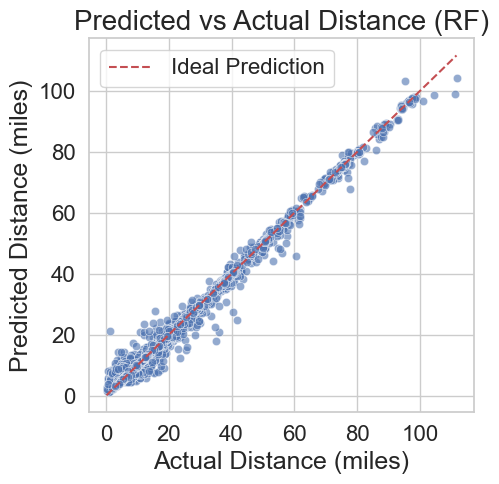

In [31]:
# Convert degrees to miles
actuals_rf_miles = [val * 69 for val in actuals_rf_dist]
predictions_rf_miles = [val * 69 for val in predictions_rf_dist]

sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(5, 5))
sns.scatterplot(x=actuals_rf_miles, y=predictions_rf_miles, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_rf_miles), max(predictions_rf_miles))
min_val = min(min(actuals_rf_miles), min(predictions_rf_miles))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Labels and title with increased font size
plt.xlabel("Actual Distance (miles)", fontsize=18)
plt.ylabel("Predicted Distance (miles)", fontsize=18)
plt.title("Predicted vs Actual Distance (RF)", fontsize=20)
plt.legend(fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

# Layout and save
plt.tight_layout()
plt.savefig('ActvsPred_RF_dist_miles.png', dpi=300, bbox_inches='tight')
plt.show()

### Gradient Boosting 

In [40]:
### Gradient Boosting (mag)
from sklearn.ensemble import GradientBoostingRegressor


# Define features and target
X = df[well_features]
y = df['mag']

# Log-transform the target
y_log = np.log1p(y)

# Bin target for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# Preprocessing: One-hot encode categoricals, pass through numericals
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# Gradient Boosting pipeline
gb_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42))
])

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Store metrics and predictions
r2_scores_gb_mag, mse_scores_gb_mag = [], []
actuals_gb_mag, predictions_gb_mag = [], []

# K-Fold training and evaluation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    gb_pipeline.fit(X_train, y_train)
    y_pred_log = gb_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_gb_mag.append(r2_score(y_val_actual, y_pred))
    mse_scores_gb_mag.append(mean_squared_error(y_val_actual, y_pred))
    actuals_gb_mag.extend(y_val_actual)
    predictions_gb_mag.extend(y_pred)

# Convert to arrays
actuals_gb_mag = np.array(actuals_gb_mag)
predictions_gb_mag = np.array(predictions_gb_mag)

# Final averaged metrics
avg_r2_gb_mag = np.mean(r2_scores_gb_mag)
avg_mse_gb_mag = np.mean(mse_scores_gb_mag)
print("Gradient Boosting R²(mag):", avg_r2_gb_mag)
print("Gradient Boosting MSE(mag):", avg_mse_gb_mag)

Gradient Boosting R²(mag): 0.7265905622429374
Gradient Boosting MSE(mag): 0.009216979635798027


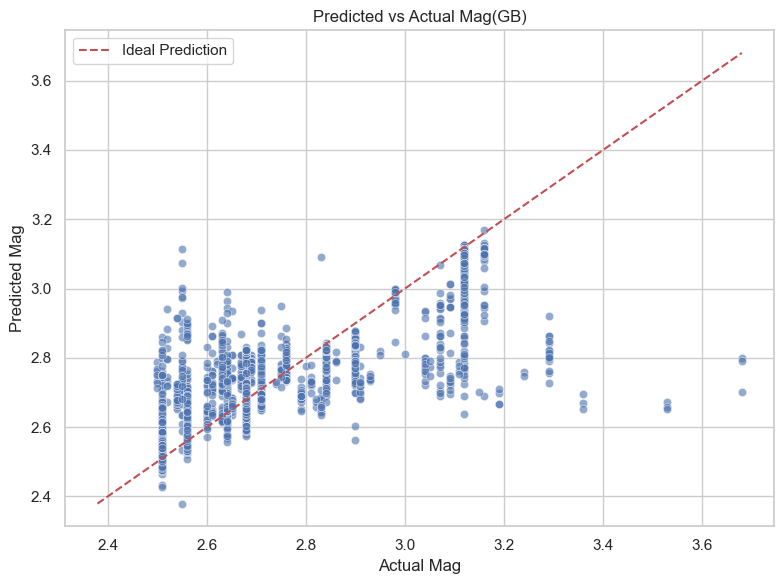

In [41]:
# Set plot style
sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=actuals_gb_mag, y=predictions_gb_mag, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_gb_mag), max(predictions_gb_mag))
min_val = min(min(actuals_gb_mag), min(predictions_gb_mag))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Label and title
plt.xlabel("Actual Mag")
plt.ylabel("Predicted Mag")
plt.title("Predicted vs Actual Mag(GB)")
plt.legend()
plt.tight_layout()
plt.show()

In [42]:
# Define features and target
X = df[well_features]
y = df['nearest_distance']

# Log-transform the target
y_log = np.log1p(y)

# Bin target for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# Preprocessing: One-hot encode categoricals, pass through numericals
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# Gradient Boosting pipeline
gb_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42))
])

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Store metrics and predictions
r2_scores_gb_dist, mse_scores_gb_dist = [], []
actuals_gb_dist, predictions_gb_dist = [], []

# K-Fold training and evaluation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    gb_pipeline.fit(X_train, y_train)
    y_pred_log = gb_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_gb_dist.append(r2_score(y_val_actual, y_pred))
    mse_scores_gb_dist.append(mean_squared_error(y_val_actual, y_pred))
    actuals_gb_dist.extend(y_val_actual)
    predictions_gb_dist.extend(y_pred)

# Convert to arrays
actuals_gb_dist = np.array(actuals_gb_dist)
predictions_gb_dist = np.array(predictions_gb_dist)

# Final averaged metrics
avg_r2_gb_dist = np.mean(r2_scores_gb_dist)
avg_mse_gb_dist = np.mean(mse_scores_gb_dist)
print("Gradient Boosting R²(Dist):", avg_r2_gb_dist)
print("Gradient Boosting MSE(Dist):", avg_mse_gb_dist)

Gradient Boosting R²(Dist): 0.968486863374074
Gradient Boosting MSE(Dist): 0.002148568176043977


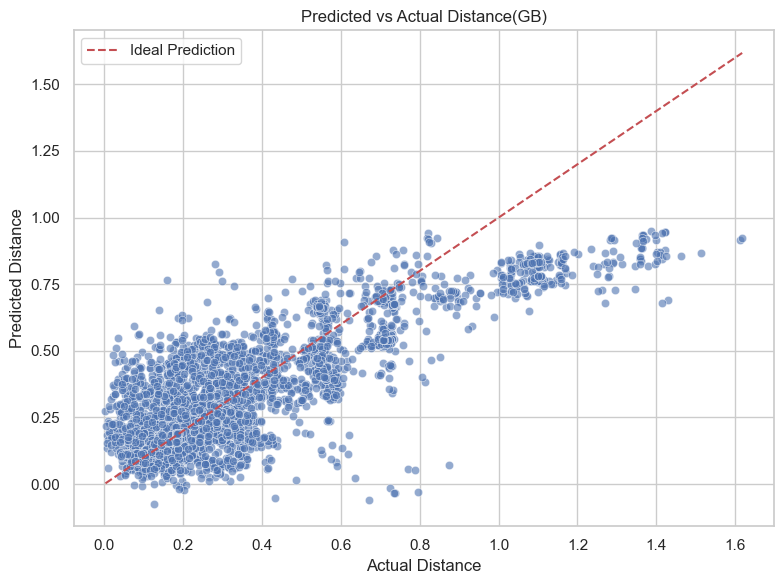

In [43]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set plot style
sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=actuals_rf_dist, y=predictions_lr_dist, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_gb_dist), max(predictions_gb_dist))
min_val = min(min(actuals_gb_dist), min(predictions_gb_dist))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Label and title
plt.xlabel("Actual Distance")
plt.ylabel("Predicted Distance")
plt.title("Predicted vs Actual Distance(GB)")
plt.legend()
plt.tight_layout()
plt.show()

## XG Boost 

In [44]:
from xgboost import XGBRegressor

# Define features and target
X = df[well_features]
y = df['mag']

# Log-transform the target
y_log = np.log1p(y)

# Bin target for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# Preprocessing: One-hot encode categoricals, pass through numericals
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# XGBoost pipeline
xgb_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42, objective='reg:squarederror'))
])

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Store metrics and predictions
r2_scores_xgb_mag, mse_scores_xgb_mag = [], []
actuals_xgb_mag, predictions_xgb_mag = [], []

# K-Fold training and evaluation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    xgb_pipeline.fit(X_train, y_train)
    y_pred_log = xgb_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_xgb_mag.append(r2_score(y_val_actual, y_pred))
    mse_scores_xgb_mag.append(mean_squared_error(y_val_actual, y_pred))
    actuals_xgb_mag.extend(y_val_actual)
    predictions_xgb_mag.extend(y_pred)

# Convert to arrays
actuals_xgb_mag = np.array(actuals_xgb_mag)
predictions_xgb_mag = np.array(predictions_xgb_mag)

# Final averaged metrics
avg_r2_xgb_mag = np.mean(r2_scores_xgb_mag)
avg_mse_xgb_mag = np.mean(mse_scores_xgb_mag)
print("XGBoost R²(mag):", avg_r2_xgb_mag)
print("XGBoost MSE(mag):", avg_mse_xgb_mag)

XGBoost R²(mag): 0.7290736582561195
XGBoost MSE(mag): 0.009137800517905909


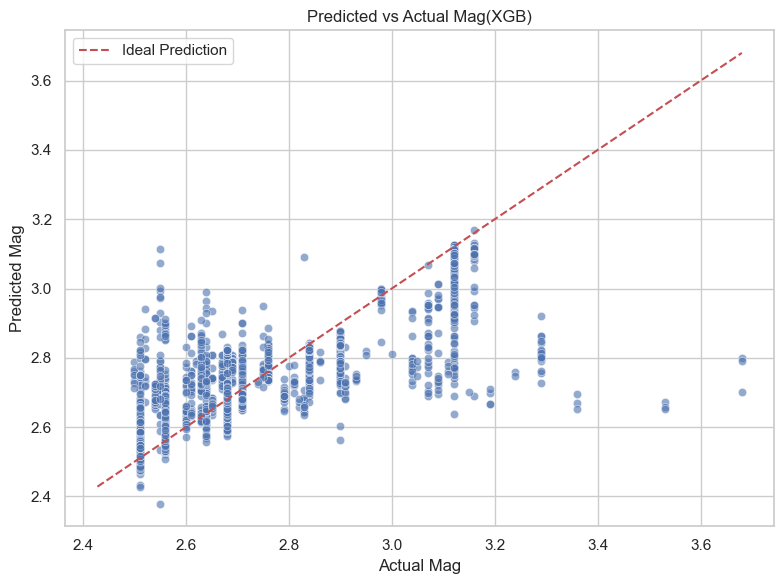

In [45]:
# Set plot style
sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=actuals_gb_mag, y=predictions_gb_mag, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_xgb_mag), max(predictions_xgb_mag))
min_val = min(min(actuals_xgb_mag), min(predictions_xgb_mag))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Label and title
plt.xlabel("Actual Mag")
plt.ylabel("Predicted Mag")
plt.title("Predicted vs Actual Mag(XGB)")
plt.legend()
plt.tight_layout()
plt.show()

In [46]:
from xgboost import XGBRegressor

# Define features and target
X = df[well_features]
y = df['nearest_distance']

# Log-transform the target
y_log = np.log1p(y)

# Bin target for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# Preprocessing: One-hot encode categoricals, pass through numericals
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# XGBoost pipeline
xgb_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42, objective='reg:squarederror'))
])

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Store metrics and predictions
r2_scores_xgb_dist, mse_scores_xgb_dist = [], []
actuals_xgb_dist, predictions_xgb_dist = [], []

# K-Fold training and evaluation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    xgb_pipeline.fit(X_train, y_train)
    y_pred_log = xgb_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_xgb_dist.append(r2_score(y_val_actual, y_pred))
    mse_scores_xgb_dist.append(mean_squared_error(y_val_actual, y_pred))
    actuals_xgb_dist.extend(y_val_actual)
    predictions_xgb_dist.extend(y_pred)

# Convert to arrays
actuals_xgb_dist = np.array(actuals_xgb_dist)
predictions_xgb_dist = np.array(predictions_xgb_dist)

# Final averaged metrics
avg_r2_xgb_dist = np.mean(r2_scores_xgb_dist)
avg_mse_xgb_dist = np.mean(mse_scores_xgb_dist)
print("XGBoost R²(Dist):", avg_r2_xgb_dist)
print("XGBoost MSE(Dist):", avg_mse_xgb_dist)

XGBoost R²(Dist): 0.9679330048810719
XGBoost MSE(Dist): 0.0021807437735728947


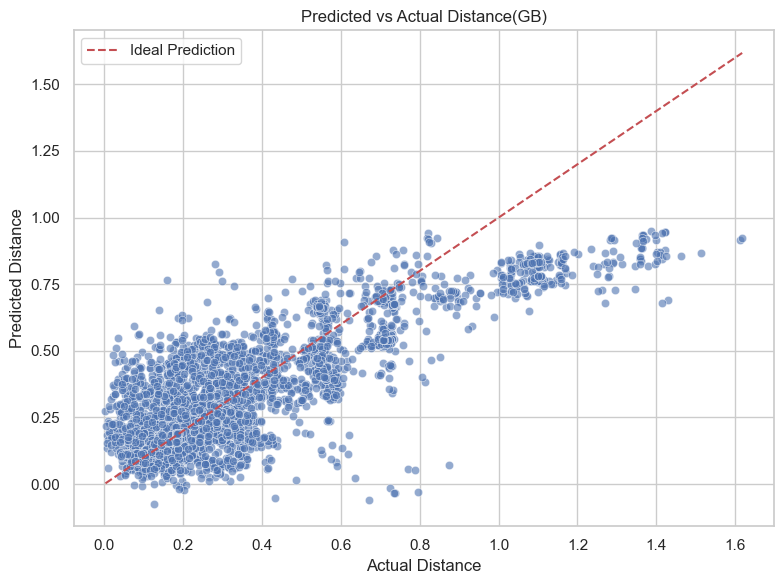

In [47]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set plot style
sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=actuals_rf_dist, y=predictions_lr_dist, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_gb_dist), max(predictions_gb_dist))
min_val = min(min(actuals_gb_dist), min(predictions_gb_dist))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Label and title
plt.xlabel("Actual Distance")
plt.ylabel("Predicted Distance")
plt.title("Predicted vs Actual Distance(GB)")
plt.legend()
plt.tight_layout()
plt.show()

## Ensemble Voting

In [49]:
from sklearn.ensemble import VotingRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor

# Define features and target
X = df[well_features]
y = df['mag']

# Log-transform the target
y_log = np.log1p(y)

# Bin target for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# Preprocessing: One-hot encode categoricals, pass through numericals
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# Define individual regressors
rf_reg = RandomForestRegressor(n_estimators=100, random_state=42)
xgb_reg = XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3,
                       objective='reg:squarederror', random_state=42)

# Ensemble Voting Regressor
voting_reg = VotingRegressor(estimators=[
    ('rf', rf_reg),
    ('xgb', xgb_reg)
])

# Full pipeline
ensemble_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', voting_reg)
])

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Store metrics and predictions
r2_scores_ensemble_mag, mse_scores_ensemble_mag = [], []
actuals_ensemble_mag, predictions_ensemble_mag = [], []

# K-Fold training and evaluation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    ensemble_pipeline.fit(X_train, y_train)
    y_pred_log = ensemble_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_ensemble_mag.append(r2_score(y_val_actual, y_pred))
    mse_scores_ensemble_mag.append(mean_squared_error(y_val_actual, y_pred))
    actuals_ensemble_mag.extend(y_val_actual)
    predictions_ensemble_mag.extend(y_pred)

# Convert to arrays
actuals_ensemble_mag = np.array(actuals_ensemble_mag)
predictions_ensemble_mag = np.array(predictions_ensemble_mag)

# Final averaged metrics
avg_r2_ensemble_mag = np.mean(r2_scores_ensemble_mag)
avg_mse_ensemble_mag = np.mean(mse_scores_ensemble_mag)
print("Ensemble Voting R²(mag):", avg_r2_ensemble_mag)
print("Ensemble Voting MSE(mag):", avg_mse_ensemble_mag)

# # Residuals
# residuals_ensemble_mag = actuals_ensemble_mag - predictions_ensemble_mag
# # Plot residuals
# plt.figure(figsize=(8, 6))
# sns.scatterplot(x=predictions_ensemble_mag, y=residuals_ensemble_mag, alpha=0.6)
# plt.axhline(0, color='red', linestyle='--')
# plt.xlabel("Predicted mag")
# plt.ylabel("Residual (Actual - Predicted)")
# plt.title("Residual Plot: Ensemble (RF + XGBoost)")
# plt.grid(True)
# plt.show()

Ensemble Voting R²(mag): 0.8177980866713368
Ensemble Voting MSE(mag): 0.006143759775871549


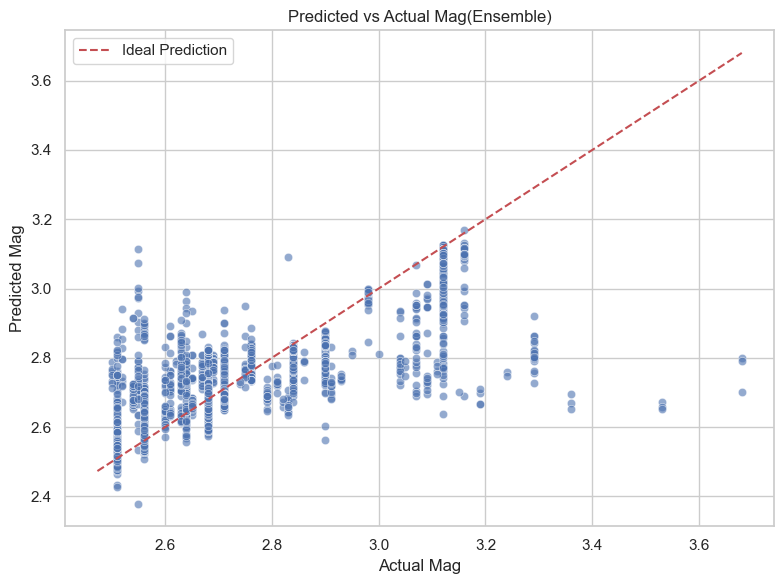

In [50]:
# Set plot style
sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=actuals_gb_mag, y=predictions_gb_mag, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_ensemble_mag), max(predictions_ensemble_mag))
min_val = min(min(actuals_ensemble_mag), min(predictions_ensemble_mag))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Label and title
plt.xlabel("Actual Mag")
plt.ylabel("Predicted Mag")
plt.title("Predicted vs Actual Mag(Ensemble)")
plt.legend()
plt.tight_layout()
plt.show()

In [52]:
# from sklearn.ensemble import VotingRegressor
# from sklearn.ensemble import RandomForestRegressor
# from xgboost import XGBRegressor

# Define features and target
X = df[well_features]
y = df['nearest_distance']

# Log-transform the target
y_log = np.log1p(y)

# Bin target for stratified K-Fold
num_bins = 5
y_binned = pd.qcut(y_log, q=num_bins, duplicates='drop', labels=False)

# Identify categorical and numerical features
categorical_features = X.select_dtypes(include='object').columns.tolist()
numerical_features = X.select_dtypes(exclude='object').columns.tolist()

# Preprocessing: One-hot encode categoricals, pass through numericals
preprocessor = ColumnTransformer(transformers=[
    ('num', 'passthrough', numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# Define individual regressors
rf_reg = RandomForestRegressor(n_estimators=100, random_state=42)
xgb_reg = XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3,
                       objective='reg:squarederror', random_state=42)

# Ensemble Voting Regressor
voting_reg = VotingRegressor(estimators=[
    ('rf', rf_reg),
    ('xgb', xgb_reg)
])

# Full pipeline
ensemble_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', voting_reg)
])

# K-Fold setup
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Store metrics and predictions
r2_scores_ensemble_dist, mse_scores_ensemble_dist = [], []
actuals_ensemble_dist, predictions_ensemble_dist = [], []

# K-Fold training and evaluation
for train_idx, val_idx in skf.split(X, y_binned):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y_log.iloc[train_idx], y_log.iloc[val_idx]

    ensemble_pipeline.fit(X_train, y_train)
    y_pred_log = ensemble_pipeline.predict(X_val)
    y_pred = np.expm1(y_pred_log)
    y_val_actual = np.expm1(y_val)

    r2_scores_ensemble_dist.append(r2_score(y_val_actual, y_pred))
    mse_scores_ensemble_dist.append(mean_squared_error(y_val_actual, y_pred))
    actuals_ensemble_dist.extend(y_val_actual)
    predictions_ensemble_dist.extend(y_pred)

# Convert to arrays
actuals_ensemble_dist = np.array(actuals_ensemble_dist)
predictions_ensemble_dist = np.array(predictions_ensemble_dist)

# Final averaged metrics
avg_r2_ensemble_dist = np.mean(r2_scores_ensemble_dist)
avg_mse_ensemble_dist = np.mean(mse_scores_ensemble_dist)
print("Ensemble Voting R²(Dist):", avg_r2_ensemble_dist)
print("Ensemble Voting MSE(Dist):", avg_mse_ensemble_dist)

# # Residuals
# residuals_ensemble_dist = actuals_ensemble_dist - predictions_ensemble_dist

# # Plot residuals
# plt.figure(figsize=(8, 6))
# sns.scatterplot(x=predictions_ensemble_dist, y=residuals_ensemble_dist, alpha=0.6)
# plt.axhline(0, color='red', linestyle='--')
# plt.xlabel("Predicted Nearest Distance")
# plt.ylabel("Residual (Actual - Predicted)")
# plt.title("Residual Plot: Ensemble (RF + XGBoost)")
# plt.grid(True)
# plt.show()

Ensemble Voting R²(Dist): 0.9857482104775233
Ensemble Voting MSE(Dist): 0.0009690178375090312


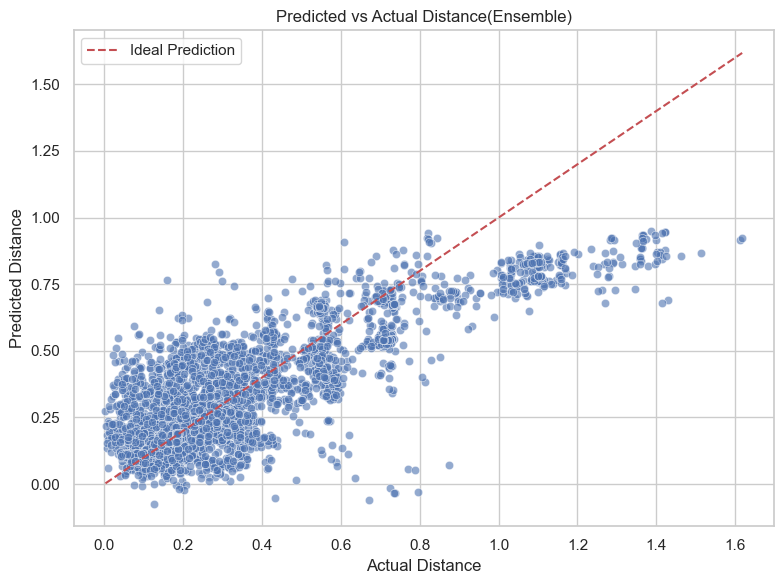

In [53]:
# Set plot style
sns.set(style='whitegrid', context='notebook')

# Create scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=actuals_rf_dist, y=predictions_lr_dist, alpha=0.6)

# Plot ideal line (perfect prediction)
max_val = max(max(actuals_ensemble_dist), max(predictions_ensemble_dist))
min_val = min(min(actuals_ensemble_dist), min(predictions_ensemble_dist))
plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Prediction')

# Label and title
plt.xlabel("Actual Distance")
plt.ylabel("Predicted Distance")
plt.title("Predicted vs Actual Distance(Ensemble)")
plt.legend()
plt.tight_layout()
plt.show()

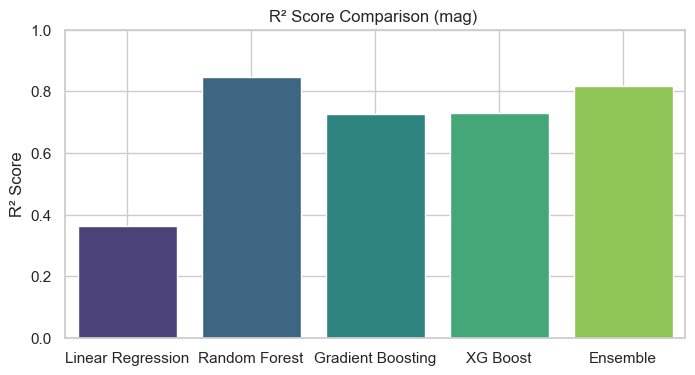

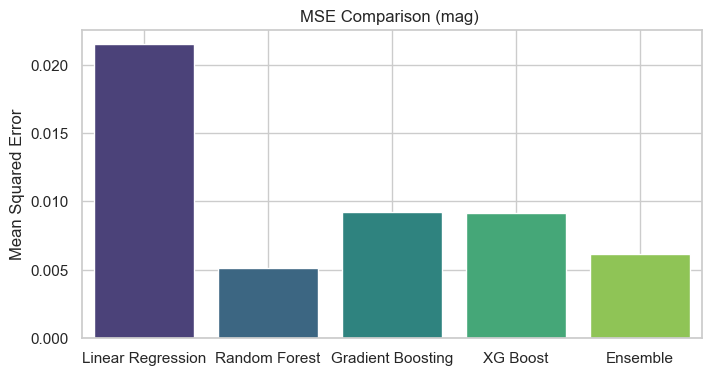

In [58]:
# Collect metrics
r2_values_mag = [avg_r2_lr_mag, avg_r2_rf_mag, avg_r2_gb_mag,avg_r2_xgb_mag,avg_r2_ensemble_mag]
mse_values_mag = [avg_mse_lr_mag, avg_mse_rf_mag, avg_mse_gb_mag,avg_mse_xgb_mag,avg_mse_ensemble_mag]
models = ['Linear Regression', 'Random Forest', 'Gradient Boosting','XG Boost', 'Ensemble']

# Plot R²
plt.figure(figsize=(8, 4))
sns.barplot(x=models, y=r2_values_mag,palette='viridis')
plt.title("R² Score Comparison (mag) ")
plt.ylabel("R² Score")
plt.ylim(0, 1)
plt.grid(True)
plt.show()

# Plot MSE
plt.figure(figsize=(8, 4))
sns.barplot(x=models, y=mse_values_mag,palette='viridis')
plt.title("MSE Comparison (mag) ")
plt.ylabel("Mean Squared Error")
plt.grid(True)
plt.show()

In [62]:

# Create a summary table
metrics_df = pd.DataFrame({
    'Model': models,
    'R² Score (mag)': r2_values_mag,
    'Mean Squared Error(mag)': mse_values_mag
})

# Optional: Format the table to 3 decimal places
metrics_df_mag = metrics_df.round(3)

# Display the table
print(metrics_df_mag)

               Model  R² Score (mag)  Mean Squared Error(mag)
0  Linear Regression           0.363                    0.021
1      Random Forest           0.847                    0.005
2  Gradient Boosting           0.727                    0.009
3           XG Boost           0.729                    0.009
4           Ensemble           0.818                    0.006


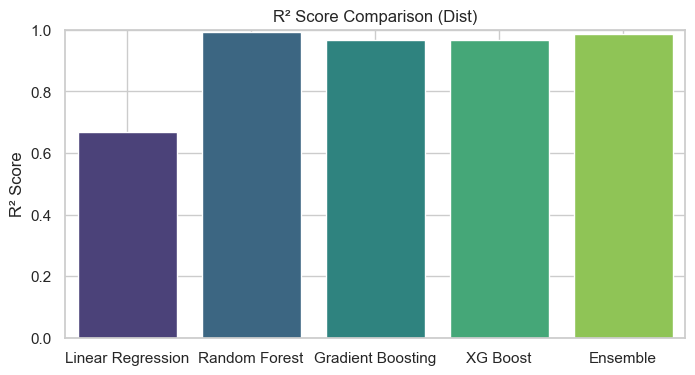

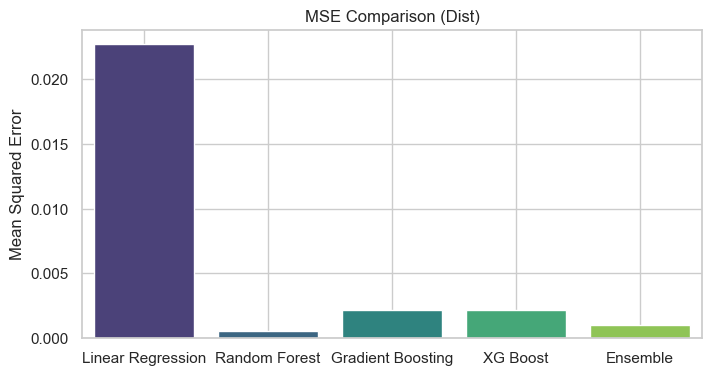

In [60]:
# Collect metrics
r2_values_dist = [avg_r2_lr_dist, avg_r2_rf_dist, avg_r2_gb_dist,avg_r2_xgb_dist,avg_r2_ensemble_dist]
mse_values_dist = [avg_mse_lr_dist, avg_mse_rf_dist, avg_mse_gb_dist,avg_mse_xgb_dist,avg_mse_ensemble_dist]
models = ['Linear Regression', 'Random Forest', 'Gradient Boosting','XG Boost', 'Ensemble']

# Plot R²
plt.figure(figsize=(8, 4))
sns.barplot(x=models, y=r2_values_dist,palette='viridis')
plt.title("R² Score Comparison (Dist)")
plt.ylabel("R² Score")
plt.ylim(0, 1)
plt.grid(True)
plt.show()

# Plot MSE
plt.figure(figsize=(8, 4))
sns.barplot(x=models, y=mse_values_dist,palette='viridis')
plt.title("MSE Comparison (Dist)")
plt.ylabel("Mean Squared Error")
plt.grid(True)
plt.show()

In [64]:

# Create a summary table
metrics_df_dist = pd.DataFrame({
    'Model': models,
    'R² Score (dist)': r2_values_dist,
    'Mean Squared Error(dist)': mse_values_dist
})

# Optional: Format the table to 3 decimal places
metrics_df_dist = metrics_df_dist.round(3)

# Display the table
print(metrics_df_dist)

               Model  R² Score (dist)  Mean Squared Error(dist)
0  Linear Regression            0.669                     0.023
1      Random Forest            0.993                     0.000
2  Gradient Boosting            0.968                     0.002
3           XG Boost            0.968                     0.002
4           Ensemble            0.986                     0.001
